# **Implementation of Swarm Intelligence**



**Author:** Brillyando Magathan Achmad - 1301204299

Objective function:

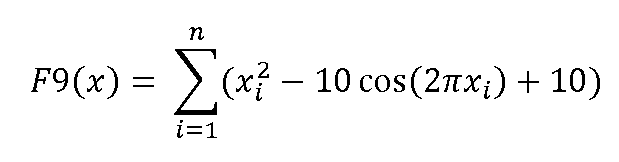

**Range** = [-5, 2.5]

**Algorithm:**
1. Particle Swarm Optimization (PSO)

2. RAO-3

In [ ]:
#Library
import numpy as np
import matplotlib.pyplot as plt
import math
import random
from matplotlib import rc
rc('animation', html='jshtml')
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

In [ ]:
#Implementation of objective function
def f9(x):
  return np.sum(x**2 - 10.0 * np.cos(2.0*np.pi*x) + 10.0)

Text(0, 0.5, 'X2')

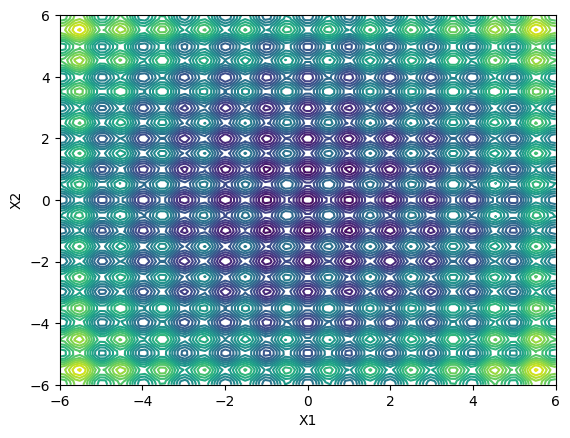

In [ ]:
#Plot Contour of the objective function
def f(x, y):
    return (x**2 - 10.0 * np.cos(2.0*np.pi*x) + 10.0) + (y**2 - 10.0 * np.cos(2.0*np.pi*y) + 10.0)

x = np.linspace(-6, 6, 100)
y = np.linspace(-6, 6, 100)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)

fig, ax = plt.subplots()

contour = ax.contour(X, Y, Z, levels=30, cmap='viridis')

ax.set_xlabel('X1')
ax.set_ylabel('X2')


## Latar Belakang Algoritma PSO

Particle Swarm Optimization merupakan sebuah algoritma optimasi yang terinspirasi dari kawanan burung yang sedang terbang (bird flocking) dan kawanan ikan yang sedang berenang (fish schooling) yang menjaga jarak di antara mereka, serta bergantung pada posisi dan kecepatannya.

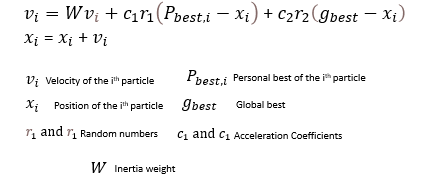

source: https://or.stackexchange.com/questions/7025/how-to-interpret-velocity-computation-in-particle-swarm-optimization

Langkah-langkah algoritma PSO:

1. Inisialisasi populasi atau partikel awal (calon solusi) dan kecepatan secara acak

2. Hitung nilai fitness dari partikel menggunakan fungsi objektif.

3. Melakukan perbandingan terhadap fitness partikel lama dengan partikel baru.

4. Memilih partikel yang memiliki fitness terbaik dan simpan.

5. Hitung perubahan kecepatan menggunakan rumus 1 (vi)

6. Update partikel menggunakan rumus 2 (xi)

7. Ulangi langkah 2 - 6 hingga kriteria berhenti terpenuhi



Parameters

In [ ]:
#Used parameter
n_particles = 5 #number of particles
n_dimension = 2 #number of dimensions
max_iteration = 300 #maximum iteration
lowest_range = -5.0
highest_range = 2.5
lr1 = lr2 = 0.5 #acceleration coefficient
w = 0.6 #weight

Functions

In [ ]:
#function to initialize initial particles
def initialize_particles(low, high, particles, dimension):
  return np.random.uniform(low, high, size=(particles, dimension))


In [ ]:
#function to initialize initial velocity
def initialize_velocity(particles, dimension):
  return np.random.rand(particles, dimension)


In [ ]:
#function to compare the fitness function between 2 "population"
#and replace it with the smaller fitness score (minimalize function)
def compare(x_pos, pbest_pos, particles):
  for i in range(particles):
    if f9(x_pos[i]) < f9(pbest_pos[i]):
      pbest_pos[i] = x_pos[i]
  return pbest_pos

In [ ]:
#function to calculate new velocity
def update_velocity(weight, velocity, lr1, pbest, x, lr2, gbest):
  r1, r2 = np.random.rand(2)
  return weight * velocity + lr1 * r1 * (pbest - x) + lr2 * r2 * (gbest-x)

In [ ]:
#function to update new position of particles
def update_particles(velocity, x):
  position = velocity + x
  if position <= -5.0:
    return -5.0
  elif position >= 2.5:
    return 2.5
  else:
    return position

## Running Program Algoritma PSO

In [ ]:
#main program

#inital particles and velocity
x = initialize_particles(lowest_range, highest_range, n_particles, n_dimension)
velocity = initialize_velocity(n_particles, n_dimension)

#initial personal best particle
pbest = x.copy()
fx = [f9(pbest[i]) for i in range(n_particles)]

#initial global best particle
gbest_idx = np.argmin(fx)
gbest = pbest[gbest_idx]

#current x
current_x = x.copy()

#history to plot the particles into the contour
hist = []

for i in range(0, max_iteration):
  #calculate the fitness score of current particles
  current_fx = [f9(x[i]) for i in range(n_particles)]

  #append the current particles to history
  hist.append(np.copy(x))

  #calculate the fitness score of personal best particles
  pbest_fx = [f9(pbest[i]) for i in range(n_particles)]

  #compare the personal best particles and current particles
  pbest = compare(x, pbest, n_particles)

  #assign the global best particles
  gbest_idx = np.argmin([f9(pbest[i]) for i in range(n_particles)])
  gbest = pbest[gbest_idx]

  #update the velocity and current particles position
  for row in range(n_particles):
    for column in range(n_dimension):
      velocity[row][column] = update_velocity(w, velocity[row][column], lr1, pbest[row][column], x[row][column], lr2, gbest[column])
      x[row][column] = velocity[row][column] + x[row][column]
  '''
  if np.all((current_x - x) == 0):
    break
  else:
    current_x = x.copy()
  '''
print("global best particles : ", gbest)
print("its fitness score: ", f9(gbest))

global best particles :  [-2.78974343e-11  1.64710745e-09]
its fitness score:  0.0


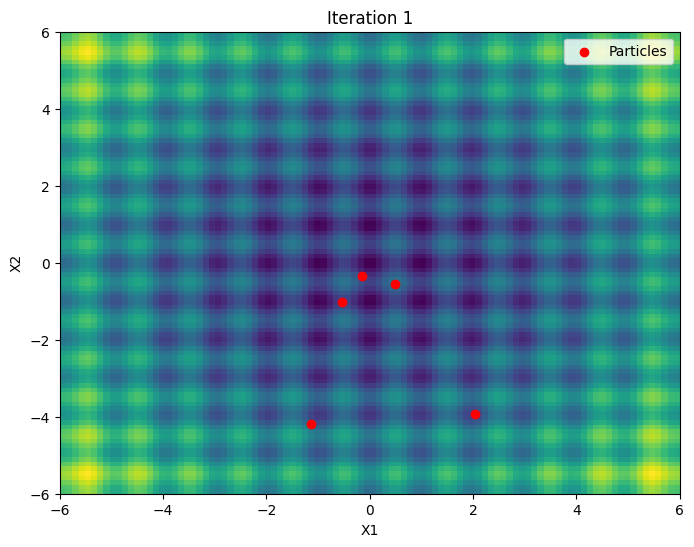

In [ ]:
#plot and animate the particles
def f(x, y):
    return (x**2 - 10.0 * np.cos(2.0*np.pi*x) + 10.0) + (y**2 - 10.0 * np.cos(2.0*np.pi*y) + 10.0)

fig, ax = plt.subplots(figsize=(8, 6))

# Update function for animation each iteration
def update(iteration):
    global hist
    plt.clf()

    x = np.linspace(-6, 6, 100)
    y = np.linspace(-6, 6, 100)
    X, Y = np.meshgrid(x, y)
    Z = f(X,Y)

    plt.imshow(Z, extent=[-6, 6, -6, 6], cmap='viridis', origin='lower', aspect='auto')
    plt.title(f'Iteration {iteration + 1}')
    plt.xlabel('X1')
    plt.ylabel('X2')

    plt.scatter(hist[iteration][:, 0].tolist(), hist[iteration][:, 1].tolist(), color='red', marker='o', label='Particles')
    plt.legend()

# Create animation
anim = FuncAnimation(fig, update, frames=max_iteration, interval=10, repeat=False)
anim

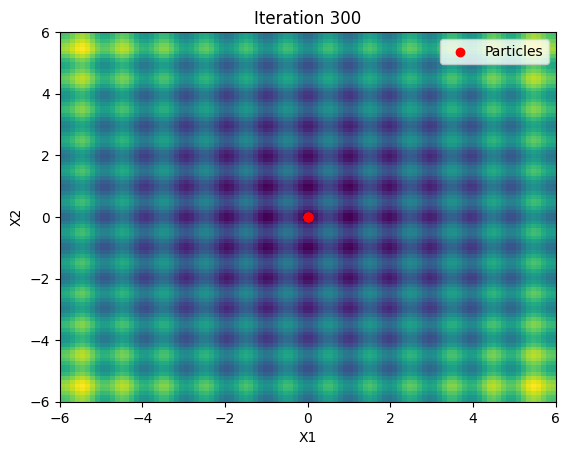

In [ ]:
#Save the animation to .gif
anim.save('PSO.gif', writer='imagemagick', fps=10)

## Latar Belakang Algoritma RAO-3

RAO-3 merupakan algoritma optimasi berdasarkan solusi terbaik dan terburuk yang diperoleh selama proses optimasi dan interaksi acak antar calon solusi. Algoritma ini akan melakukan update terhadap posisi calon solusi berdasarkan rumus berikut:

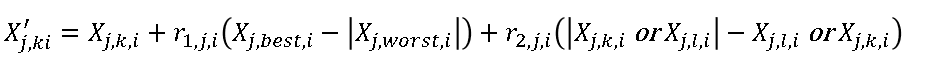

di mana nilai r1 dan r2 adalah bilangan random antara 0 dan 1


Langkah-langkah algoritma RAO-3:
1. inisialisasi calon solusi
2. Menghitung nilai fitness calon solusi
3. Memilih calon solusi dengan fitness terbaik dan terburuk
4. Memperbarui posisi semua calon solusi
5. Melakukan perbandingan terhadap semua calon solusi lama dan semua calon solusi yang diperbarui. Jika nilai fitness calon solusi lama lebih kecil (minimize) dari pada calon solusi yang diperbarui, maka calon solusi lama akan dipertahankan.
6. Calon solusi yang diperbarui akan menjadi calon solusi lama pada iterasi selanjutnya
7. Ulangi langkah 2 - 6 hingga kriteria berhenti terpenuhi.

In [ ]:
#used parameter
max_iteration = 300 #maximum iteration
n_solutions = 6 #candidate solution
n_dimension = 2 #dimension
low_range = -5
high_range = 2.5

In [ ]:
def initialize_solution(low, high, solution, dimension):
  return np.random.uniform(low, high, size=(solution, dimension))

In [ ]:
#function to compare the fitness function between 2 "population"
#and replace it with the smaller fitness score (minimalize function)
def compare(current_x, updated_x, particles):
  for i in range(particles):
    if f9(current_x[i]) < f9(updated_x[i]):
      updated_x[i] = current_x[i]
  return updated_x

In [ ]:
#funtion to pick random num and unique accross the n_solutions
def random_num(picked_num, low=0, high=n_solutions-1):
  while True:
    number = random.randint(low, high)
    #print(num)
    #print(picked_num)
    if number not in picked_num:
      return number

## Running Program Algoritma RAO-3

In [ ]:
#main

#list to catch the random number
picked_number = []
#list to plot the solutions (population) into the contour
history_rao3 = []

#initial solution (population)
x = initialize_solution(low_range, high_range, n_solutions, n_dimension)
for i in range(max_iteration):
  #x_update will be updated by the equation
  x_update = x.copy()
  r1, r2 = np.random.rand(2)

  #the fitness score of current solution
  fx = [f9(x[i]) for i in range(n_solutions)]

  #best and worst index fitness function in current solution
  best = np.argmin(fx)
  worst = np.argmax(fx)

  #random a number for interaction between 2 solution
  for j in range(n_solutions):
    while True:
      num = random_num(picked_number, 0, n_solutions-1)
      if j == n_solutions-2 and n_solutions-1 not in picked_number:
        num = n_solutions-1
      if num != j:
        break
    picked_number.append(num)

    #compare the fitness function between the 2 solution
    for k in range(n_dimension):
      if f9(x[j][k]) < f9(x[num][k]):
        select1 = x[j][k]
        select2 = x[num][k]
      else:
        select1 = x[num][k]
        select2 = x[j][k]
      #update the x_update
      x_update[j][k] = x[j][k] + r1 * (x[best][k] - abs(x[worst][k])) + r2 * (abs(select1) - select2)

  #calculate the fitness value of x_update
  fx_update = [f9(x_update[i]) for i in range(n_solutions)]

  #compare the current position and the updated position (x_update)
  x = compare(x, x_update, n_solutions)

  #append the compared position to history
  history_rao3.append(np.copy(x))
  picked_number = []

fx_final = [f9(x[i]) for i in range(n_solutions)]
print("Best solution: ", x[np.argmin(fx_final)])
print("its fitness score: ", fx_final[np.argmin(fx_final)])


Best solution:  [5.70198427e-10 8.95711124e-10]
its fitness score:  0.0


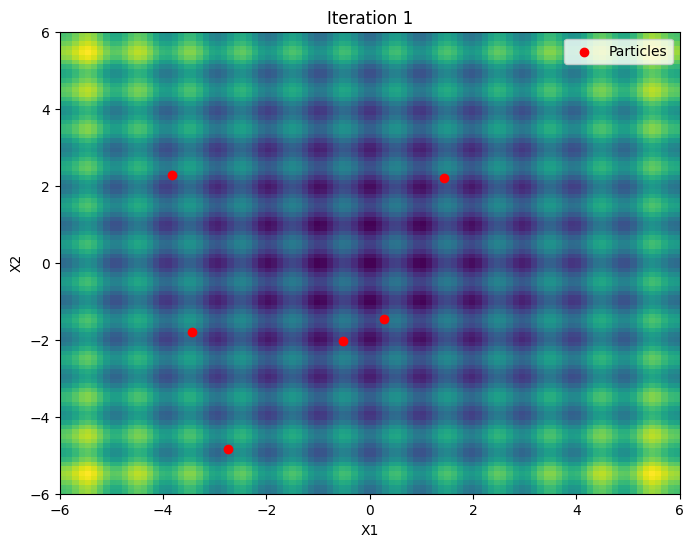

In [ ]:
#plot and animate the particles
def f(x, y):
    return (x**2 - 10.0 * np.cos(2.0*np.pi*x) + 10.0) + (y**2 - 10.0 * np.cos(2.0*np.pi*y) + 10.0)

fig, ax = plt.subplots(figsize=(8, 6))

# Update function for animation each iteration
def update(iteration):
    global hist
    plt.clf()

    x = np.linspace(-6, 6, 100)
    y = np.linspace(-6, 6, 100)
    X, Y = np.meshgrid(x, y)
    Z = f(X,Y)

    plt.imshow(Z, extent=[-6, 6, -6, 6], cmap='viridis', origin='lower', aspect='auto')
    plt.title(f'Iteration {iteration + 1}')
    plt.xlabel('X1')
    plt.ylabel('X2')

    plt.scatter(history_rao3[iteration][:, 0].tolist(), history_rao3[iteration][:, 1].tolist(), color='red', marker='o', label='Particles')
    plt.legend()

# Create animation
animation = FuncAnimation(fig, update, frames=max_iteration, interval=10, repeat=False)
animation

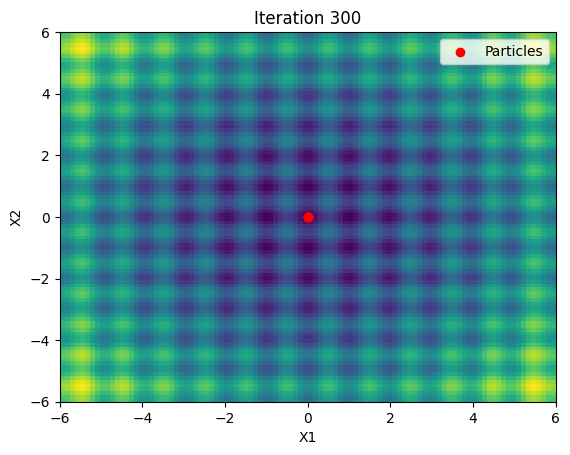

In [ ]:
#Save the animation to .gif
animation.save('RAO3.gif', writer='imagemagick', fps=10)

# Hasil dan Analisis

## Algoritma PSO

Optimasi PSO pada tubes kali ini memiliki **global partikel terbaik** yaitu di titik (-2.78974343e-11, 1.64710745e-09) dengan *fitness score* yaitu 0.0. Maksimal iterasi yang dipilih adalah 300, dikarenakan setelah melakukan *trial and error*, kriteria optimal algoritma untuk berhenti berada di angka 250 - 300. Pada range [-5, 2.5] dan memiliki 5 partikel, algoritma PSO yang telah dibangun ini telah optimal. Plot dari pergerakan partikel ini menunjukkan bahwa partikel saling bergerak ke 1 titik yang dianggap terbaik.


## Algoritma RAO-3

Parameter dari algoritma RAO-3 yang telah dibangun ini, yaitu 2 dimensi, range [-5, 2.5], dan memiliki 6 calon solusi. Setelah dilakukan iterasi sebanyak 300 kali, algoritma RAO-3 bergerak menuju titik [0,0] dengan solusi terbaiknya yaitu di titik (5.70198427e-10, 8.95711124e-10) dan *fitness score*-nya sebesar 0.0. Pergerakan calon solusi yang divisualisasikan lewat *plot* saling bergerak ke titik optimal, sehingga dapat dikatakan algoritma RAO-3 memiliki performa yang baik

## Kesimpulan

Algoritma PSO dan RAO-3 telah dibangun dan memiliki performa yang sesuai harapan. Jika dilihat dari plot kedua algoritma, algoritma PSO lebih "luwes" pergerakannya dibandingkan dengan RAO-3. Tetapi, keduanya mampu bergerak ke titik optimal [0, 0]. Meskipun begitu, ketika dilakukan eksekusi ulang, titik tidak selamanya bergerak ke arah [0, 0]. Hal ini dikarenakan adanya beberapa faktor seperti pengaturan parameter dan bilangan acak (r1, r2) yang tidak konstan (selalu berubah) sehingga algoritma tidak selalu bergerak ke arah [0, 0]

Link video : https://youtu.be/36shbm51j3Q

